In [3]:
!pip install rasterio

   ---------------------------------------- 0.0/25.4 MB ? eta -:--:--
   ---------- ----------------------------- 6.6/25.4 MB 44.9 MB/s eta 0:00:01
   ----------------------------- ---------- 18.9/25.4 MB 49.6 MB/s eta 0:00:01
   ---------------------------------------- 25.4/25.4 MB 44.8 MB/s eta 0:00:00

   ---------------------------------------- 0/8 [pyparsing]
   ----- ---------------------------------- 1/8 [click]
   ----- ---------------------------------- 1/8 [click]
   --------------- ------------------------ 3/8 [attrs]
   --------------- ------------------------ 3/8 [attrs]
   ------------------------- -------------- 5/8 [cligj]
   ----------------------------------- ---- 7/8 [rasterio]
   ----------------------------------- ---- 7/8 [rasterio]
   ----------------------------------- ---- 7/8 [rasterio]
   ----------------------------------- ---- 7/8 [rasterio]
   ----------------------------------- ---- 7/8 [rasterio]
   ----------------------------------- ---- 7/8 [rasterio]

In [2]:
# Importamos las librerías necesarias
import os
import rasterio


In [156]:

# Definimos la ruta de la carpeta donde están las imágenes
carpeta_imagenes = "Samples"

# Iteramos sobre todos los archivos TIFF en la carpeta
for nombre_archivo in os.listdir(carpeta_imagenes):
    if nombre_archivo.lower().endswith(('.tif', '.tiff')):
        ruta_completa = os.path.join(carpeta_imagenes, nombre_archivo)
        print(f"\n--- Análisis de la imagen: {nombre_archivo} ---")
        
        # Abrimos la imagen con rasterio
        with rasterio.open(ruta_completa) as src:
            # Dimensiones en píxeles
            ancho = src.width
            alto = src.height

            # Número de bandas
            num_bandas = src.count

            # Resolución espacial (tamaño del píxel en unidades del sistema de coordenadas)
            resolucion = src.res  # (res_x, res_y)

            print(f"Dimensiones (pixeles): {ancho} x {alto}")
            print(f"Número de bandas: {num_bandas}")
            print(f"Resolución espacial: {resolucion[0]} x {resolucion[1]} (unidad según CRS)")

            # Sistema de referencia de coordenadas
            print(f"CRS (Sistema de coordenadas): {src.crs}")



--- Análisis de la imagen: elevation_single_batch_0.tif ---
Dimensiones (pixeles): 415 x 377
Número de bandas: 1
Resolución espacial: 0.1598600000000014 x 0.15985999999999947 (unidad según CRS)
CRS (Sistema de coordenadas): EPSG:32618

--- Análisis de la imagen: elevation_single_batch_1.tif ---
Dimensiones (pixeles): 755 x 773
Número de bandas: 1
Resolución espacial: 0.1598600000000014 x 0.15985999999999947 (unidad según CRS)
CRS (Sistema de coordenadas): EPSG:32618

--- Análisis de la imagen: elevation_single_batch_2.tif ---
Dimensiones (pixeles): 389 x 393
Número de bandas: 1
Resolución espacial: 0.1598600000000014 x 0.15985999999999947 (unidad según CRS)
CRS (Sistema de coordenadas): EPSG:32618

--- Análisis de la imagen: single_batch_0.tif ---
Dimensiones (pixeles): 2067 x 1879
Número de bandas: 3
Resolución espacial: 1.0 x 1.0 (unidad según CRS)
CRS (Sistema de coordenadas): None

--- Análisis de la imagen: single_batch_1.tif ---
Dimensiones (pixeles): 3769 x 3858
Número de banda

c:\Users\EsSe009\Documents\Vision\EDA_Proyecto\.venv\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Division de una imagen en parches

In [4]:

import matplotlib.pyplot as plt
import numpy as np

# Parámetros
carpeta_imagenes = "Samples"
tamano_parche = 150

# Buscar la primera imagen TIFF en la carpeta
imagen_tiff = None
for archivo in os.listdir(carpeta_imagenes):
    if archivo.lower().endswith(('.tif', '.tiff')):
        imagen_tiff = os.path.join(carpeta_imagenes, 'single_batch_0.tif')
        break

if imagen_tiff is None:
    raise FileNotFoundError("No se encontró ninguna imagen TIFF en la carpeta Samples.")

# Abrimos la imagen
with rasterio.open(imagen_tiff) as src:
    # Leemos todas las bandas como array numpy (shape: bandas, alto, ancho)
    imagen = src.read()
    # Reordenamos a (alto, ancho, bandas) para matplotlib
    imagen = np.transpose(imagen, (1, 2, 0))
    alto, ancho, _ = imagen.shape

    # Dividimos la imagen en parches de 200x200
    parches = []
    for y in range(0, alto, tamano_parche):
        for x in range(0, ancho, tamano_parche):
            parche = imagen[y:y+tamano_parche, x:x+tamano_parche]
            # Solo agregamos parches completos
            if parche.shape[0] == tamano_parche and parche.shape[1] == tamano_parche:
                parches.append(parche)

# Mostramos información
print(f"\nImagen seleccionada: {os.path.basename(imagen_tiff)}")
print(f"Tamaño original: {alto} x {ancho} píxeles")
print(f"Número total de parches (200x200): {len(parches)}")

# Función para mostrar un parche
def mostrar_parche(indice):
    if 0 <= indice < len(parches):
        plt.imshow(parches[indice])
        plt.title(f"Parche #{indice}")
        plt.axis('off')
        plt.show()
    else:
        print(f"Índice fuera de rango. Usa un número entre 0 y {len(parches)-1}")



Imagen seleccionada: single_batch_0.tif
Tamaño original: 1879 x 2067 píxeles
Número total de parches (200x200): 156


c:\Users\EsSe009\Documents\Vision\EDA_Proyecto\.venv\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


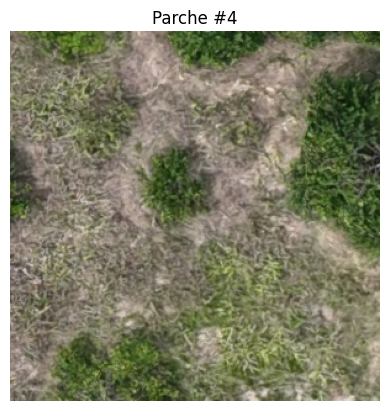

In [ ]:

# Ejemplo: mostramos el parche 0


# Para ver otro parche, simplemente llama a:
# mostrar_parche(N)


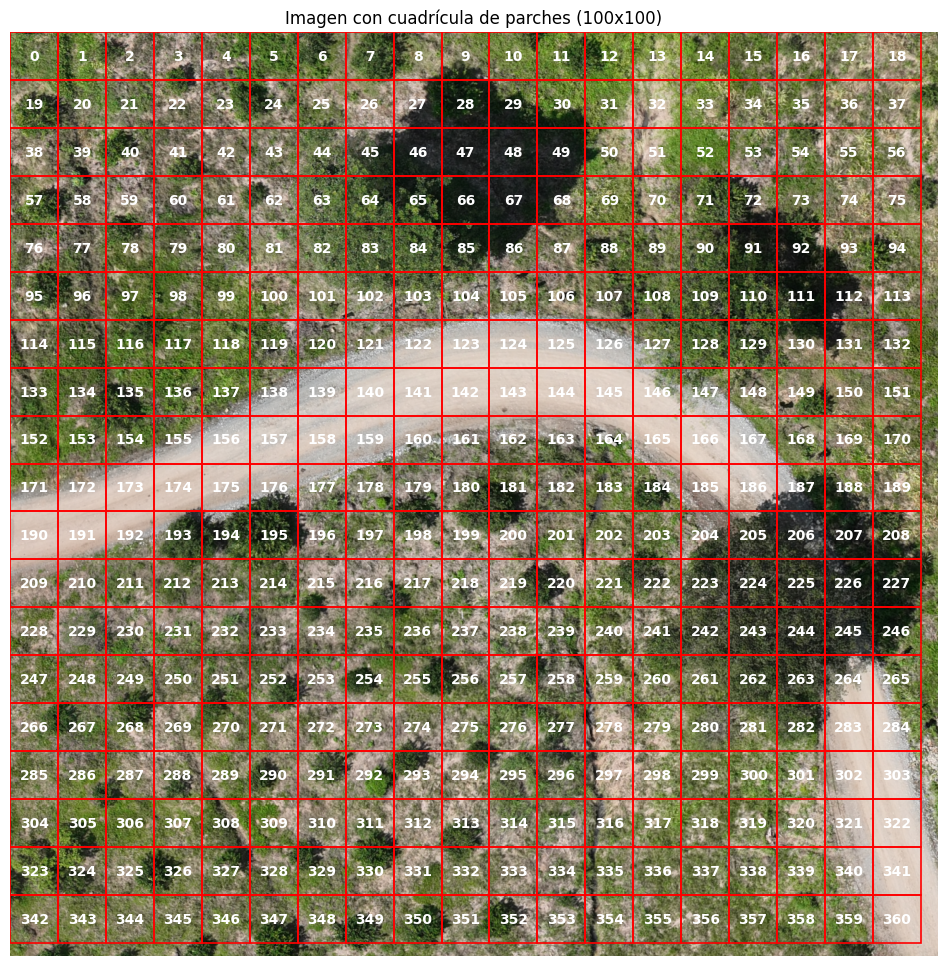

In [199]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np
import rasterio
import os

# Parámetros
carpeta_imagenes = "Samples"
tamano_parche = 100

# Buscar primera imagen TIFF
imagen_tiff = None
for archivo in os.listdir(carpeta_imagenes):
    if archivo.lower().endswith(('.tif', '.tiff')):
        imagen_tiff = os.path.join(carpeta_imagenes, "single_batch_2.tif")
        break

if imagen_tiff is None:
    raise FileNotFoundError("No se encontró ninguna imagen TIFF en la carpeta Samples.")

# Leer la imagen
with rasterio.open(imagen_tiff) as src:
    imagen = src.read()
    imagen = np.transpose(imagen, (1, 2, 0))  # Reordenar a (alto, ancho, bandas)
    alto, ancho, _ = imagen.shape

# Mostrar la imagen completa con la cuadrícula
fig, ax = plt.subplots(figsize=(12, 12))
ax.imshow(imagen)
ax.set_title("Imagen con cuadrícula de parches (100x100)")
ax.axis('off')

# Dibujar rectángulos de la cuadrícula y numerarlos
indice = 0
for y in range(0, alto, tamano_parche):
    for x in range(0, ancho, tamano_parche):
        if y + tamano_parche <= alto and x + tamano_parche <= ancho:
            rect = patches.Rectangle((x, y), tamano_parche, tamano_parche,
                                     linewidth=1.2, edgecolor='red', facecolor='none')
            ax.add_patch(rect)
            # Coordenadas para numerar el parche
            ax.text(x + tamano_parche // 2, y + tamano_parche // 2,
                    str(indice), color='white', fontsize=10,
                    ha='center', va='center', weight='bold')
            indice += 1

plt.show()


Histogramas para cada banda de color

In [8]:
def histograma_parche_rgb(indice):
    if 0 <= indice < len(parches):
        parche = parches[indice]
        
        # Crear subplots para las 3 bandas
        fig, axes = plt.subplots(1, 3, figsize=(15, 4))
        colores = ['red', 'green', 'blue']
        titulos = ['Rojo (R)', 'Verde (G)', 'Azul (B)']

        for i in range(3):
            banda = parche[:, :, i].flatten()
            axes[i].hist(banda, bins=256, color=colores[i], alpha=0.8)
            axes[i].set_title(f"Histograma - {titulos[i]}")
            axes[i].set_xlabel("Intensidad")
            axes[i].set_ylabel("Frecuencia")
            axes[i].set_xlim(0, 255)
        
        fig.suptitle(f"Histogramas del Parche #{indice}", fontsize=14)
        plt.tight_layout()
        plt.show()
    else:
        print(f"Índice fuera de rango. Usa un número entre 0 y {len(parches)-1}")


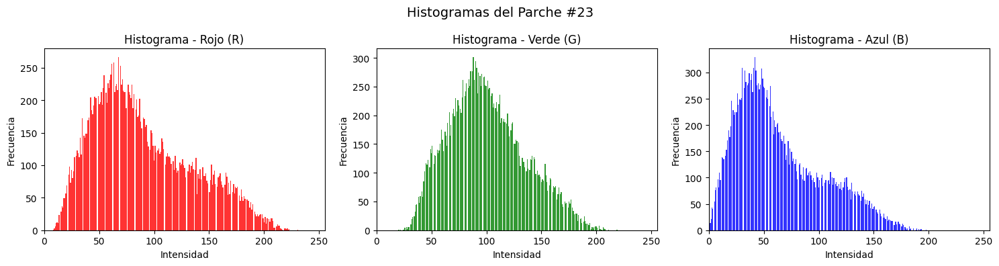

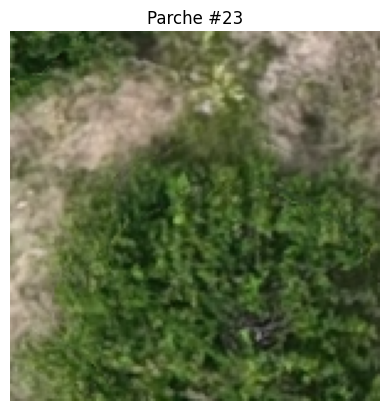

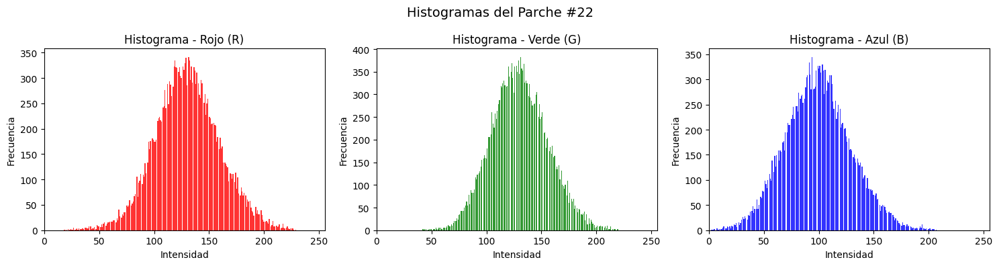

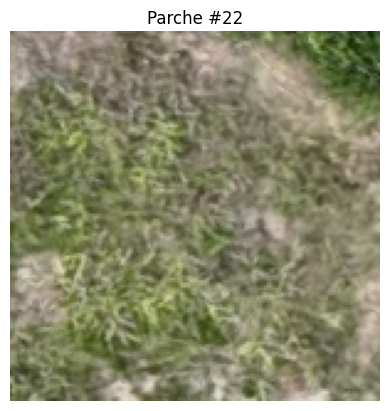

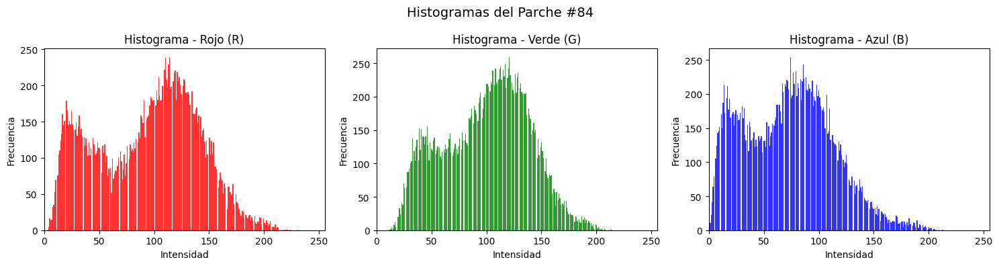

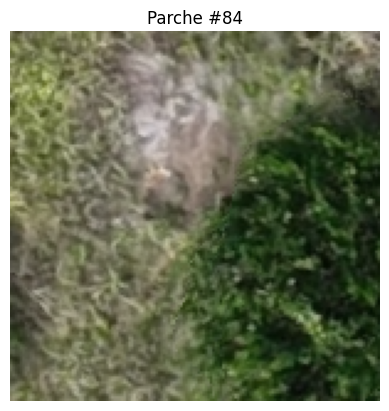

In [ ]:
parche=23

histograma_parche_rgb(parche)  # Cambia 5 por el índice del parche que te interesa
mostrar_parche(parche)

parche=22

histograma_parche_rgb(parche)  # Cambia 5 por el índice del parche que te interesa
mostrar_parche(parche)

parche=84

histograma_parche_rgb(parche)  # Cambia 5 por el índice del parche que te interesa
mostrar_parche(parche)

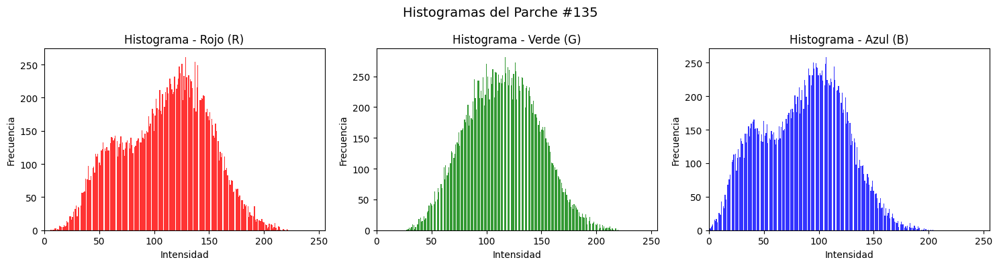

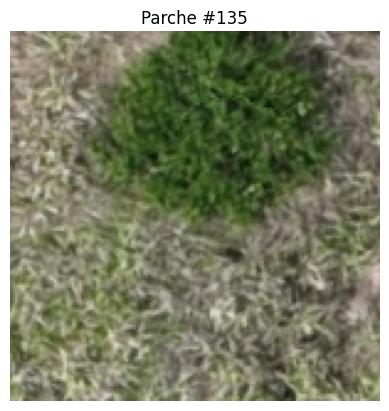

In [54]:
parche=135

histograma_parche_rgb(parche)  # Cambia 5 por el índice del parche que te interesa
mostrar_parche(parche)

In [12]:
def generar_patches_solapados(imagen, tamano=150, stride=50):
    """
    Divide la imagen en parches RGB con o sin solapamiento.

    Parámetros:
    - imagen: array (alto, ancho, 3)
    - tamano: tamaño del parche en píxeles (default=200)
    - stride: cantidad de píxeles entre parches (default=200). Si stride < tamano hay solapamiento.

    Retorna:
    - lista de parches (cada uno es un array (tamano, tamano, 3))
    """
    alto, ancho, _ = imagen.shape
    parches = []

    for y in range(0, alto - tamano + 1, stride):
        for x in range(0, ancho - tamano + 1, stride):
            parche = imagen[y:y+tamano, x:x+tamano]
            parches.append(parche)

    print(f"Se generaron {len(parches)} parches de {tamano}x{tamano} con stride {stride}")
    return parches




In [7]:
imagen_tiff = os.path.join("Samples", "single_batch_0.tif")
with rasterio.open(imagen_tiff) as src:
    imagen = src.read()
    imagen = np.transpose(imagen, (1, 2, 0))  # Reordenar a (alto, ancho, bandas)
parches=generar_patches_solapados(imagen,150,50)

Se generaron 1365 parches de 150x150 con stride 50


c:\Users\EsSe009\Documents\Vision\EDA_Proyecto\.venv\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


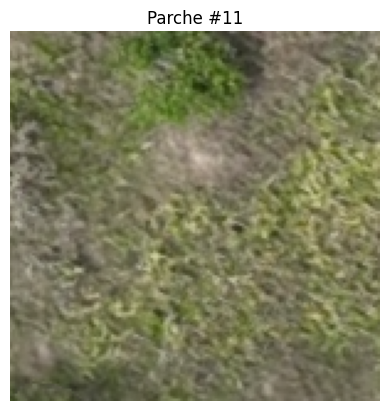

In [18]:
mostrar_parche(11)

In [11]:

def construir_vectores_caracteristicas(parches, bins=256):
    """
    Construye vectores de características a partir de histogramas RGB de cada parche.

    Parámetros:
    - parches: lista de arrays (alto, ancho, 3)
    - bins: número de bins por histograma (por defecto 256)

    Retorna:
    - X: array numpy de forma (n_patches, bins * 3)
    """
    caracteristicas = []

    for parche in parches:
        vector = []
        for i in range(3):  # R, G, B
            hist, _ = np.histogram(parche[:, :, i], bins=bins, range=(0, 256), density=True)
            vector.extend(hist)
        caracteristicas.append(vector)

    X = np.array(caracteristicas)
    print(f"Se construyó una matriz de características con forma: {X.shape}")
    return X

In [ ]:
from sklearn.cluster import KMeans

def aplicar_kmeans(X, n_clusters=4, random_state=42):
    """
    Aplica K-Means sobre la matriz de características.

    Parámetros:
    - X: array de forma (n_patches, n_features)
    - n_clusters: número de grupos a generar
    - random_state: semilla para reproducibilidad

    Retorna:
    - labels: array con la etiqueta de cluster para cada parche
    - modelo_kmeans: el objeto KMeans entrenado
    """
    print(f"Aplicando K-Means con {n_clusters} clusters...")
    kmeans = KMeans(n_clusters=n_clusters, random_state=random_state,)
    labels = kmeans.fit_predict(X)
    print("K-Means finalizado.")
    return labels, kmeans


In [14]:
import matplotlib.pyplot as plt

def visualizar_histogramas_promedio(X, labels, bins=256):
    """
    Visualiza los histogramas promedio por clúster (una gráfica por clúster, con subgráficos R-G-B).

    Parámetros:
    - X: matriz de características (n_samples, 768)
    - labels: etiquetas de clúster
    - bins: número de bins usados en cada histograma
    """
    n_clusters = len(np.unique(labels))
    colores = ['red', 'green', 'blue']
    titulos = ['Rojo (R)', 'Verde (G)', 'Azul (B)']

    for cl in range(n_clusters):
        indices = np.where(labels == cl)[0]
        hist_cl = X[indices]  # Subconjunto del clúster
        promedio = hist_cl.mean(axis=0)

        fig, axes = plt.subplots(1, 3, figsize=(15, 4))
        fig.suptitle(f"Histograma promedio - Clúster {cl}", fontsize=14)

        for i in range(3):
            inicio = i * bins
            fin = (i + 1) * bins
            axes[i].plot(promedio[inicio:fin], color=colores[i])
            axes[i].set_title(titulos[i])
            axes[i].set_xlabel("Intensidad")
            axes[i].set_ylabel("Frecuencia")
            axes[i].set_xlim(0, bins - 1)

        plt.tight_layout()
        plt.show()


In [15]:
import matplotlib.pyplot as plt
import numpy as np

def mostrar_ejemplos_cluster(parches, labels, cluster=0, max_muestras=10):
    """
    Muestra una galería de imágenes de ejemplo para un clúster específico.

    Parámetros:
    - parches: lista de arrays (cada uno es un parche RGB)
    - labels: etiquetas del clúster para cada parche
    - cluster: número de clúster a mostrar
    - max_muestras: cantidad de parches a mostrar (por defecto 10)
    """
    indices = np.where(labels == cluster)[0]
    
    if len(indices) == 0:
        print(f"No hay parches asignados al clúster {cluster}.")
        return

    muestras = indices[:max_muestras]  # Tomamos las primeras N
    n = len(muestras)

    cols = 5
    rows = (n + cols - 1) // cols

    fig, axes = plt.subplots(rows, cols, figsize=(15, 3 * rows))
    fig.suptitle(f"{n} ejemplos del clúster {cluster}", fontsize=16)

    for i in range(rows * cols):
        ax = axes[i // cols, i % cols] if rows > 1 else axes[i]
        if i < n:
            ax.imshow(parches[muestras[i]])
            ax.set_title(f"Parche #{muestras[i]}")
        ax.axis('off')

    plt.tight_layout()
    plt.show()


In [128]:
from sklearn.preprocessing import normalize
imagen_tiff = os.path.join("Samples", "single_batch_2.tif")
with rasterio.open(imagen_tiff) as src:
    imagen = src.read()
    imagen = np.transpose(imagen, (1, 2, 0))  # Reordenar a (alto, ancho, bandas)
parches=generar_patches_solapados(imagen,30,10)
X = construir_vectores_caracteristicas(parches)

X = normalize(X, norm='l2')  # L2 = coseno equivalente


c:\Users\EsSe009\Documents\Vision\EDA_Proyecto\.venv\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Se generaron 36290 parches de 30x30 con stride 10
Se construyó una matriz de características con forma: (36290, 768)


Aplicando K-Means con 4 clusters...
K-Means finalizado.


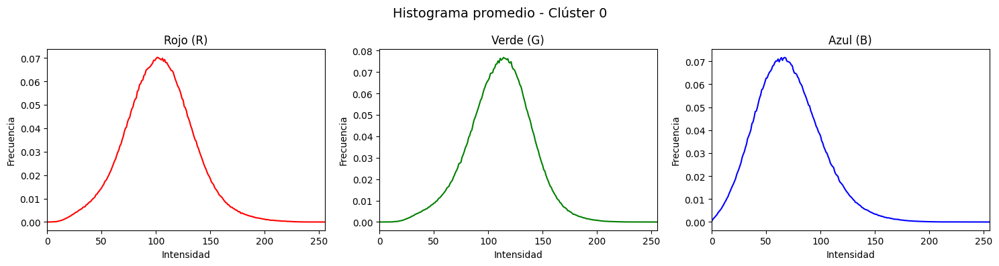

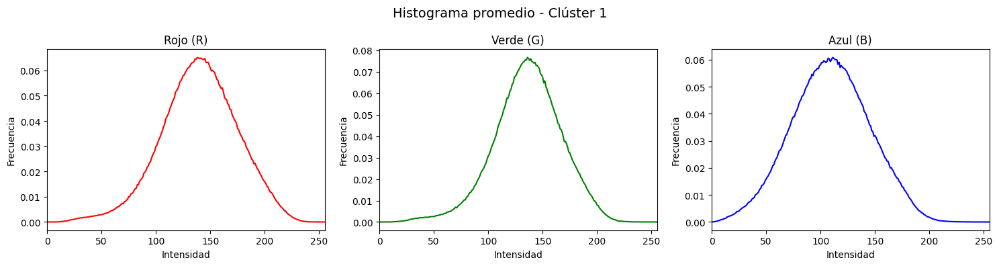

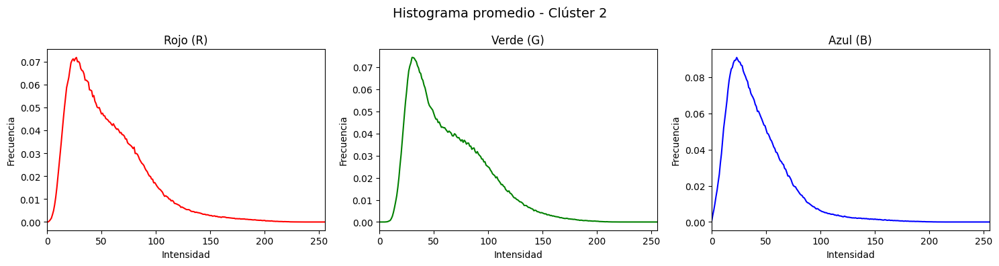

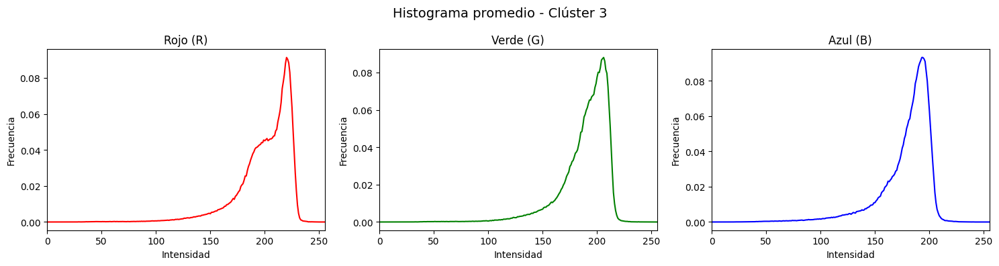

In [129]:
labels, modelo = aplicar_kmeans(X, n_clusters=4)         
visualizar_histogramas_promedio(X,labels)

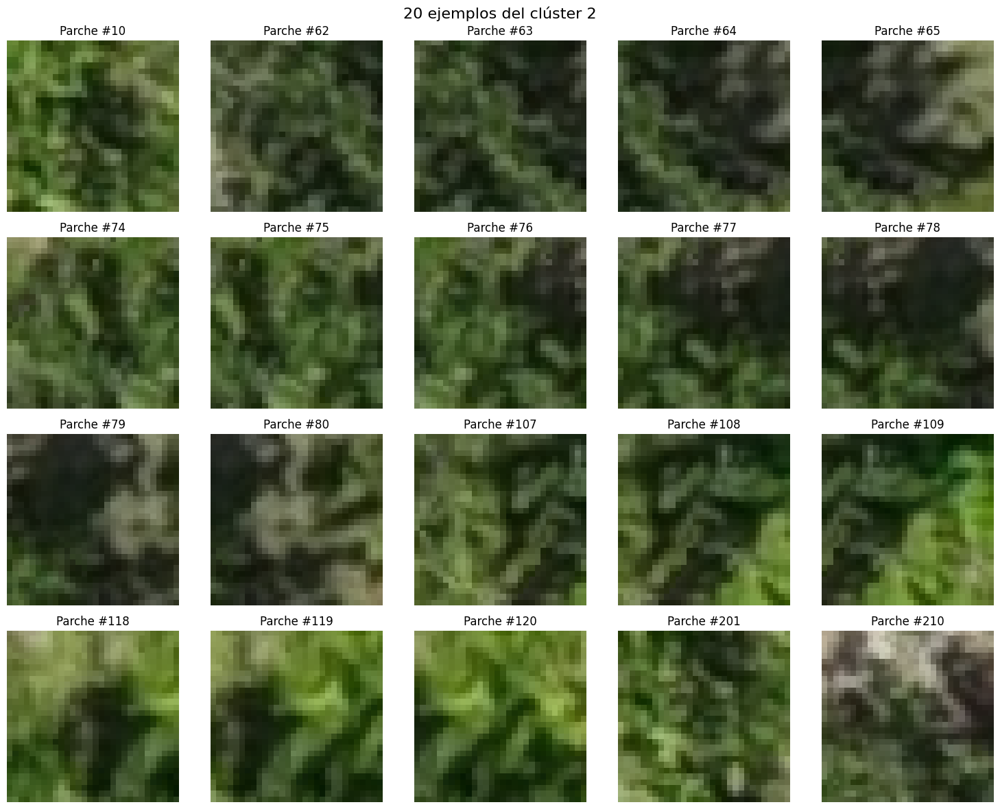

In [130]:
mostrar_ejemplos_cluster(parches,labels,2,max_muestras=20)

In [120]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np
from sklearn.preprocessing import normalize

def visualizar_cluster_por_parche(imagen, modelo, tamano=200, stride=200, normalizar=True):
    """
    Divide la imagen en parches y predice su clúster con un modelo KMeans entrenado.
    Dibuja los cuadros y el número de clúster en cada uno.

    Parámetros:
    - imagen: array RGB original (alto, ancho, 3)
    - modelo: modelo KMeans ya entrenado
    - tamano: tamaño de los parches (default 200x200)
    - stride: paso entre parches (default 200, sin solapamiento)
    - normalizar: si se normaliza el histograma como en el entrenamiento
    """
    alto, ancho, _ = imagen.shape
    fig, ax = plt.subplots(figsize=(12, 12))
    ax.imshow(imagen)
    ax.set_title("Clasificación de parches por clúster")
    ax.axis("off")

    for y in range(0, alto - tamano + 1, stride):
        for x in range(0, ancho - tamano + 1, stride):
            parche = imagen[y:y+tamano, x:x+tamano]
            if parche.shape[0] == tamano and parche.shape[1] == tamano:
                # Construimos histograma
                vector = []
                for i in range(3):
                    hist, _ = np.histogram(parche[:, :, i], bins=256, range=(0, 256), density=normalizar)
                    vector.extend(hist)
                vector = np.array(vector).reshape(1, -1)

                # Predicción de clúster
                cluster = modelo.predict(vector)[0]
                vector=normalize(vector, norm='l2') 
               
                # Dibujamos el recuadro
                rect = patches.Rectangle((x, y), tamano, tamano, linewidth=1.2, edgecolor='lime', facecolor='none')
                ax.add_patch(rect)

                # Número de clúster
                ax.text(x + tamano // 2, y + tamano // 2, str(cluster),
                        color='white', fontsize=10, ha='center', va='center')#, bbox=dict(boxstyle='round', fc='white', alpha=0.2))

    plt.show()


In [206]:

def visualizar_mapa_clusters_coloreado(imagen, modelo, tamano=200, stride=200, normalizar=True, alpha=0.4,clustersP=[1,2],Title="Mapa de clústeres sobre imagen",bins=256):
    """
    Visualiza la imagen original superpuesta con colores por clúster (con transparencia).

    Parámetros:
    - imagen: imagen RGB original (H x W x 3)
    - modelo: modelo KMeans entrenado
    - tamano: tamaño del parche (en píxeles)
    - stride: paso entre parches
    - normalizar: si se normaliza el histograma como en el entrenamiento
    - alpha: transparencia del overlay (0 a 1)
    - clustersP: Clusters para visualizar
    """
    alto, ancho, _ = imagen.shape
    cluster_map = np.zeros_like(imagen, dtype=np.uint8)

    # Paleta de colores por clúster
    np.random.seed(42)  # Semilla para colores consistentes
    colores_cluster = np.random.randint(0, 255, size=(modelo.n_clusters, 3), dtype=np.uint8)

    for y in range(0, alto - tamano + 1, stride):
        for x in range(0, ancho - tamano + 1, stride):
            parche = imagen[y:y+tamano, x:x+tamano]
            if parche.shape[0] == tamano and parche.shape[1] == tamano:
                # Vector de histograma
                vector = []
                for i in range(3):
                    hist, _ = np.histogram(parche[:, :, i], bins=bins, range=(0, 256), density=normalizar)
                    vector.extend(hist)
                vector = np.array(vector).reshape(1, -1)
                vector=normalize(vector,"l2")
                # Predicción de clúster
                cluster = modelo.predict(vector)[0]
                color = colores_cluster[cluster]

                # Pintamos el parche en el mapa de clúster
                if cluster in clustersP:
                    cluster_map[y:y+tamano, x:x+tamano] = color
                else:
                    cluster_map[y:y+tamano, x:x+tamano]=0


    # Mostrar imagen original + superposición de clúster
    plt.figure(figsize=(12, 12))
    plt.imshow(imagen)
    plt.imshow(cluster_map, alpha=alpha)
    plt.title(Title)
    plt.axis("off")
    plt.show()


c:\Users\EsSe009\Documents\Vision\EDA_Proyecto\.venv\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


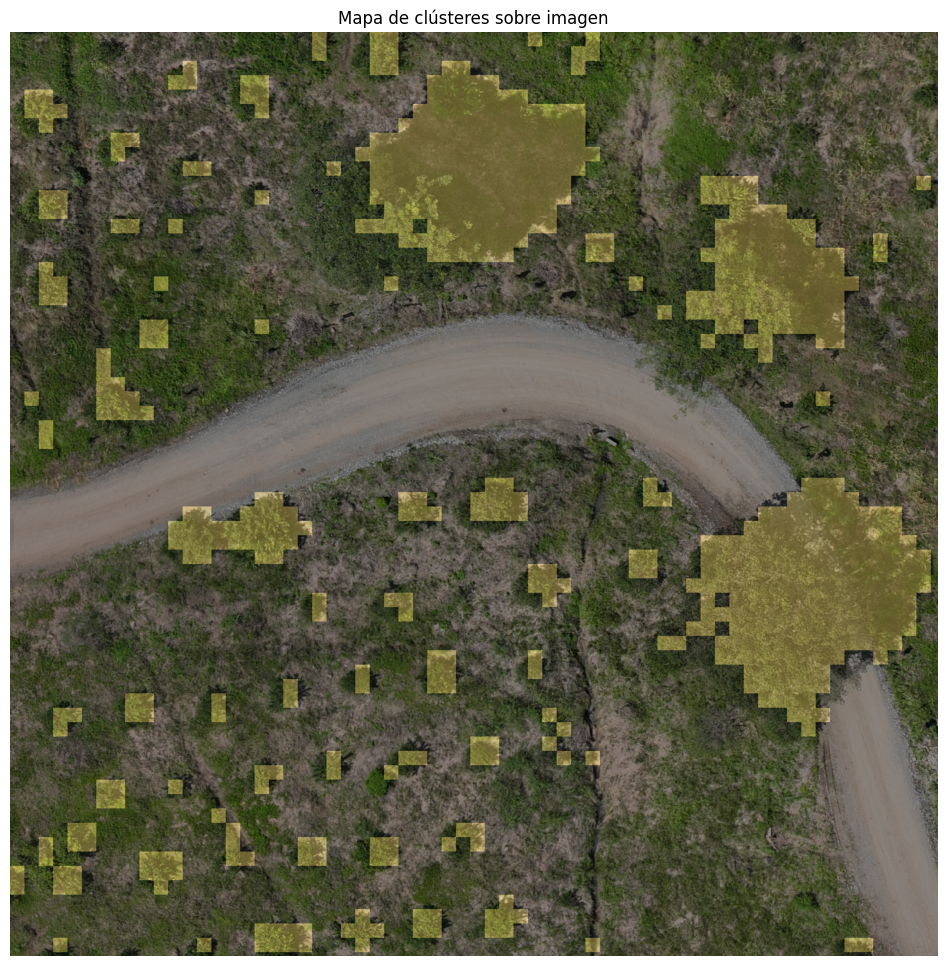

In [131]:
imagen_tiff = os.path.join("Samples", "single_batch_2.tif")
with rasterio.open(imagen_tiff) as src:
    imagen = src.read()
    imagen = np.transpose(imagen, (1, 2, 0))  # Reordenar a (alto, ancho, bandas)
visualizar_mapa_clusters_coloreado(imagen, modelo, tamano=30, stride=30,alpha=0.4)


In [153]:
from scipy.stats import mode
import numpy as np

def reconstruir_mapa_clusters(imagen, labels, tamano=200, stride=100, cluster_prioritario=2,umbral=2):
    """
    Reconstruye un mapa de etiquetas por pixel a partir de los parches, asignando por moda,
    pero con prioridad absoluta al clúster indicado si está presente en los votos.

    Parámetros:
    - imagen: array RGB (H x W x 3)
    - labels: lista de etiquetas (1 por parche)
    - tamano: tamaño del parche
    - stride: desplazamiento entre parches
    - cluster_prioritario: etiqueta a priorizar si está presente (por defecto 2)

    Retorna:
    - mapa_etiquetas: array 2D (H x W) con etiquetas por pixel
    """
    alto, ancho, _ = imagen.shape

    # Creamos una matriz de listas para almacenar los votos
    votos = np.empty((alto, ancho), dtype=object)
    for y in range(alto):
        for x in range(ancho):
            votos[y, x] = []

    index = 0
    for y in range(0, alto - tamano + 1, stride):
        for x in range(0, ancho - tamano + 1, stride):
            if index >= len(labels):
                break
            etiqueta = labels[index]
            for i in range(y, y + tamano):
                for j in range(x, x + tamano):
                    votos[i, j].append(etiqueta)
            index += 1
            print(index)

    # Creamos el mapa final aplicando la prioridad
    mapa_etiquetas = np.zeros((alto, ancho), dtype=np.uint8)
    for y in range(alto):
        for x in range(ancho):
            
            if votos[y, x]:
                
                if votos[y, x].count(cluster_prioritario)>umbral :
                        mapa_etiquetas[y, x] = cluster_prioritario
                else:
                    mapa_etiquetas[y, x] = mode(votos[y, x], keepdims=False).mode
            else:
                mapa_etiquetas[y, x] = 0  # sin voto
        if y%100==0:
            print(y)
    return mapa_etiquetas


In [124]:
def visualizar_mapa_reconstruido(imagen, mapa_etiquetas, cluster_destacado=2, alpha=0.5, color_destacado=(255, 0, 0)):
    """
    Muestra la imagen con superposición solo del clúster deseado, en color y con transparencia.

    Parámetros:
    - imagen: array RGB original
    - mapa_etiquetas: array 2D (H x W) con etiquetas por pixel
    - cluster_destacado: número de clúster a mostrar
    - alpha: transparencia del overlay
    - color_destacado: tupla RGB para el color del clúster (por defecto rojo)
    """
    alto, ancho, _ = imagen.shape
    overlay = np.zeros((alto, ancho, 3), dtype=np.uint8)

    # Asignamos color solo donde el cluster coincide
    mascara = (mapa_etiquetas == cluster_destacado)
    overlay[mascara] = color_destacado

    # Mostrar con transparencia
    plt.figure(figsize=(12, 12))
    plt.imshow(imagen)
    plt.imshow(overlay, alpha=alpha)
    plt.title(f"Región del clúster {cluster_destacado}", fontsize=14)
    plt.axis("off")
    plt.show()



In [154]:
mapa = reconstruir_mapa_clusters(imagen, labels, tamano=30, stride=10,umbral=2)


1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277


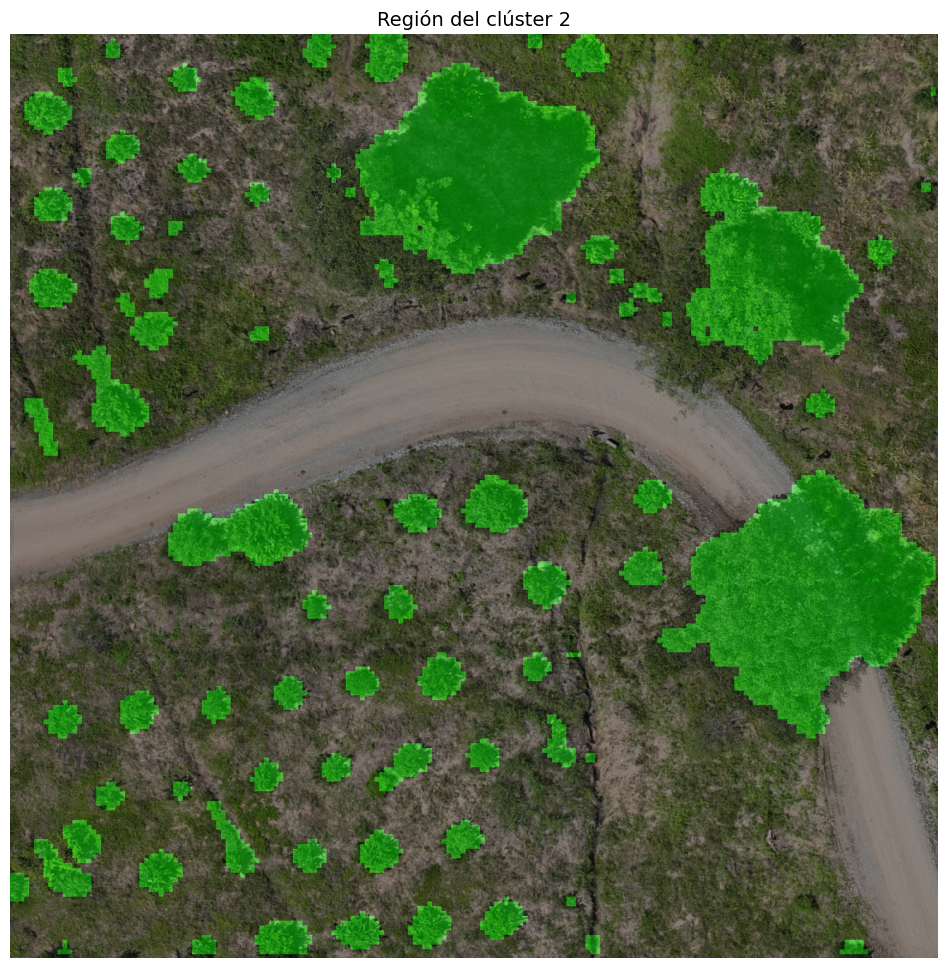

In [155]:
visualizar_mapa_reconstruido(imagen, mapa, alpha=0.4,color_destacado=(0,255,0),cluster_destacado=2)


Procesamiento completo de una imagen

In [ ]:
Xs=[]
for imm in range(3):
    imagen_tiff = os.path.join("Samples", f"single_batch_{imm}.tif")
    with rasterio.open(imagen_tiff) as src:
        imagen = src.read()
        imagen = np.transpose(imagen, (1, 2, 0))  # Reordenar a (alto, ancho, bandas)
    parches=generar_patches_solapados(imagen,30,10)
    Xs.append( construir_vectores_caracteristicas(parches))
X=np.concatenate(Xs)


Se generaron 37740 parches de 30x30 con stride 10
Se construyó una matriz de características con forma: (37740, 768)
Se generaron 143242 parches de 30x30 con stride 10
Se construyó una matriz de características con forma: (143242, 768)
Se generaron 36290 parches de 30x30 con stride 10
Se construyó una matriz de características con forma: (36290, 768)


"X = normalize(X, norm='l2')  # L2 = coseno equivalente\n\nlabels, modelo = aplicar_kmeans(X, n_clusters=4)         \nvisualizar_histogramas_promedio(X,labels)\n"

(217272, 768)
Aplicando K-Means con 6 clusters...
K-Means finalizado.


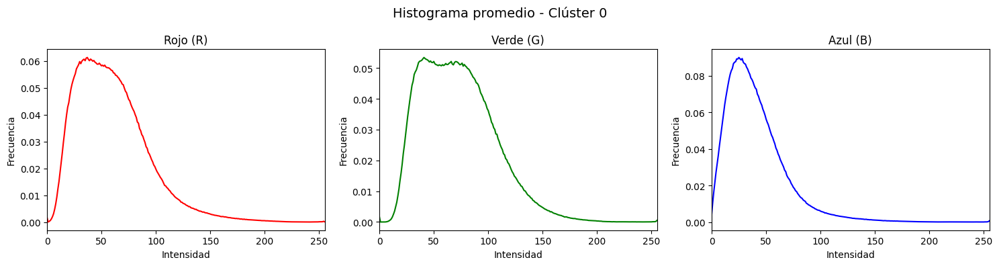

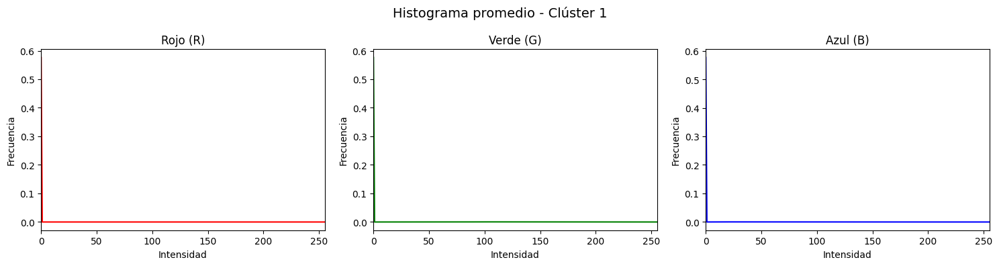

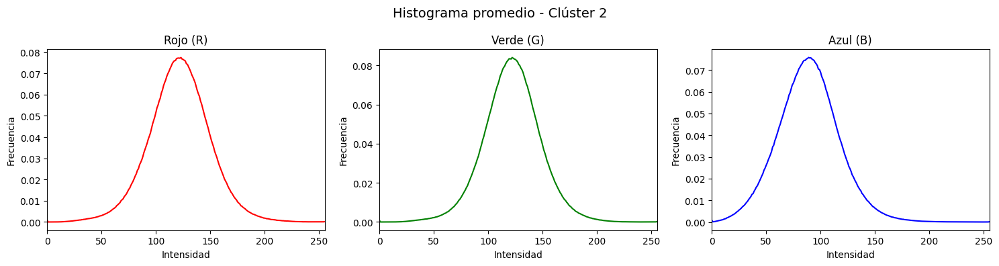

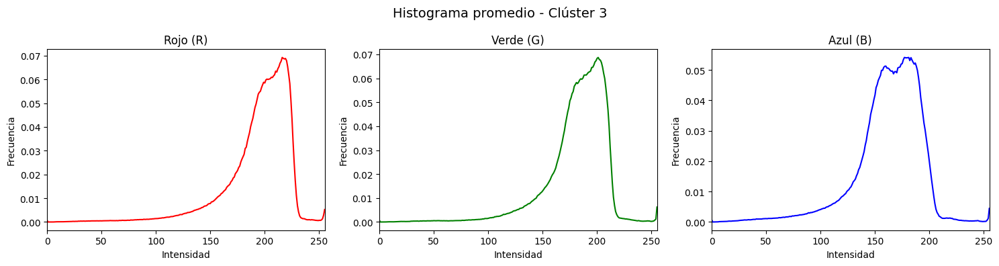

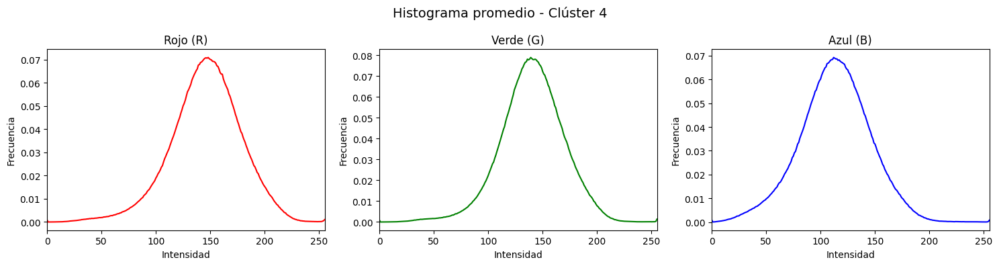

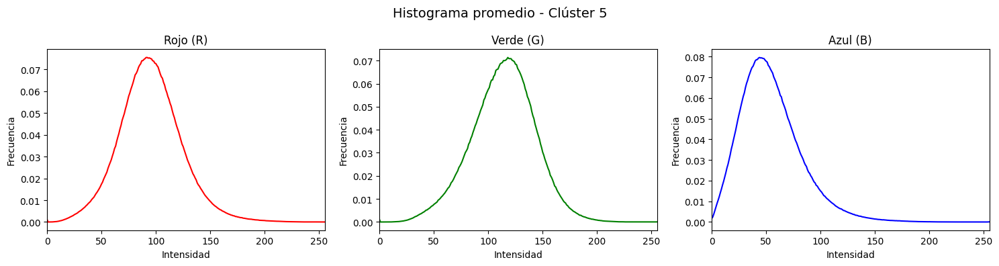

In [186]:

print(X.shape)
X = normalize(X, norm='l2')  # L2 = coseno equivalente

labels, modelo = aplicar_kmeans(X, n_clusters=6)         
visualizar_histogramas_promedio(X,labels)


c:\Users\EsSe009\Documents\Vision\EDA_Proyecto\.venv\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


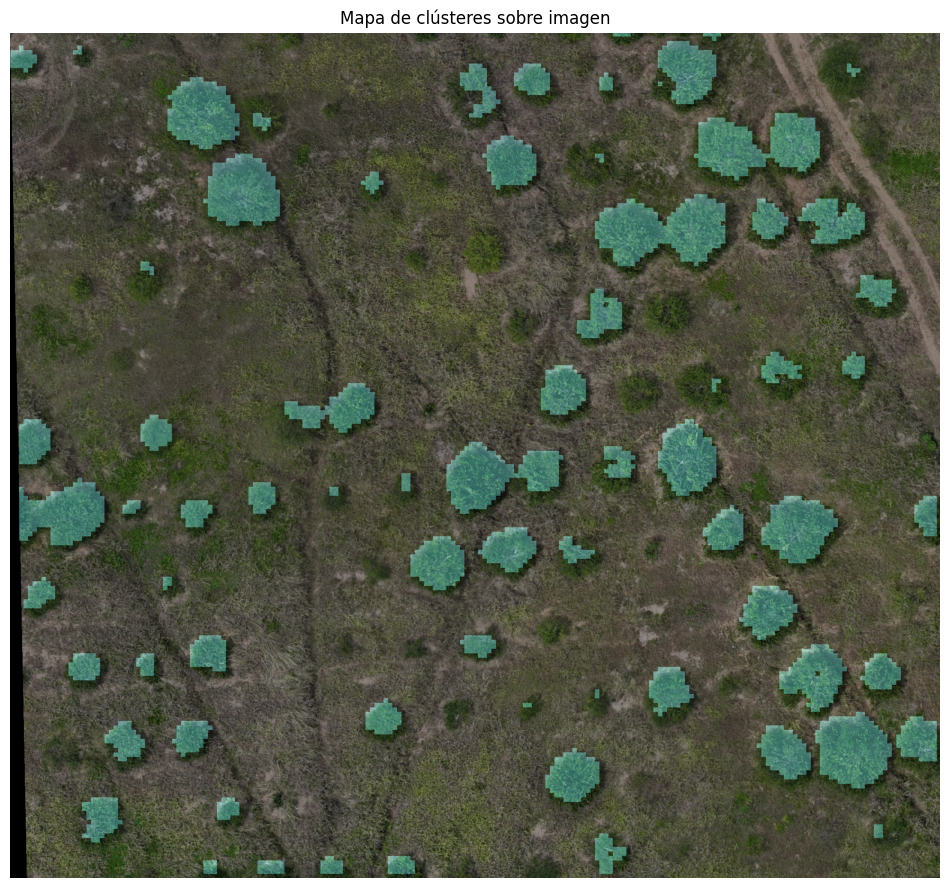

c:\Users\EsSe009\Documents\Vision\EDA_Proyecto\.venv\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


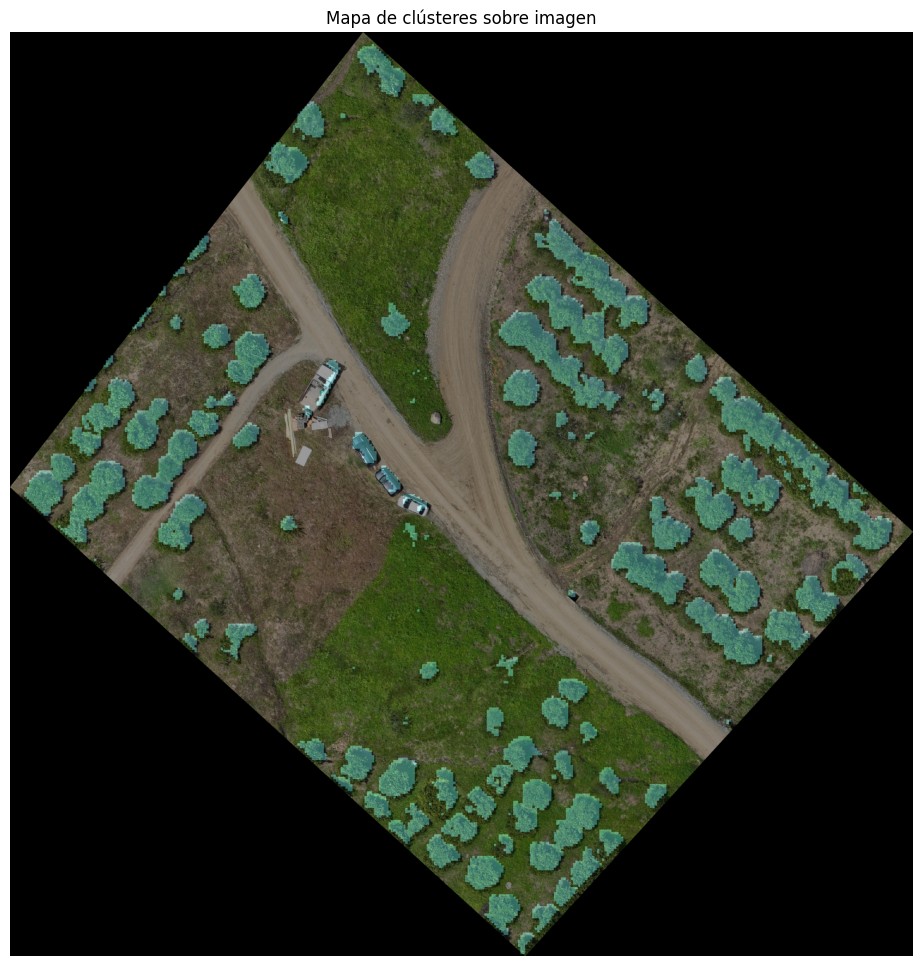

c:\Users\EsSe009\Documents\Vision\EDA_Proyecto\.venv\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


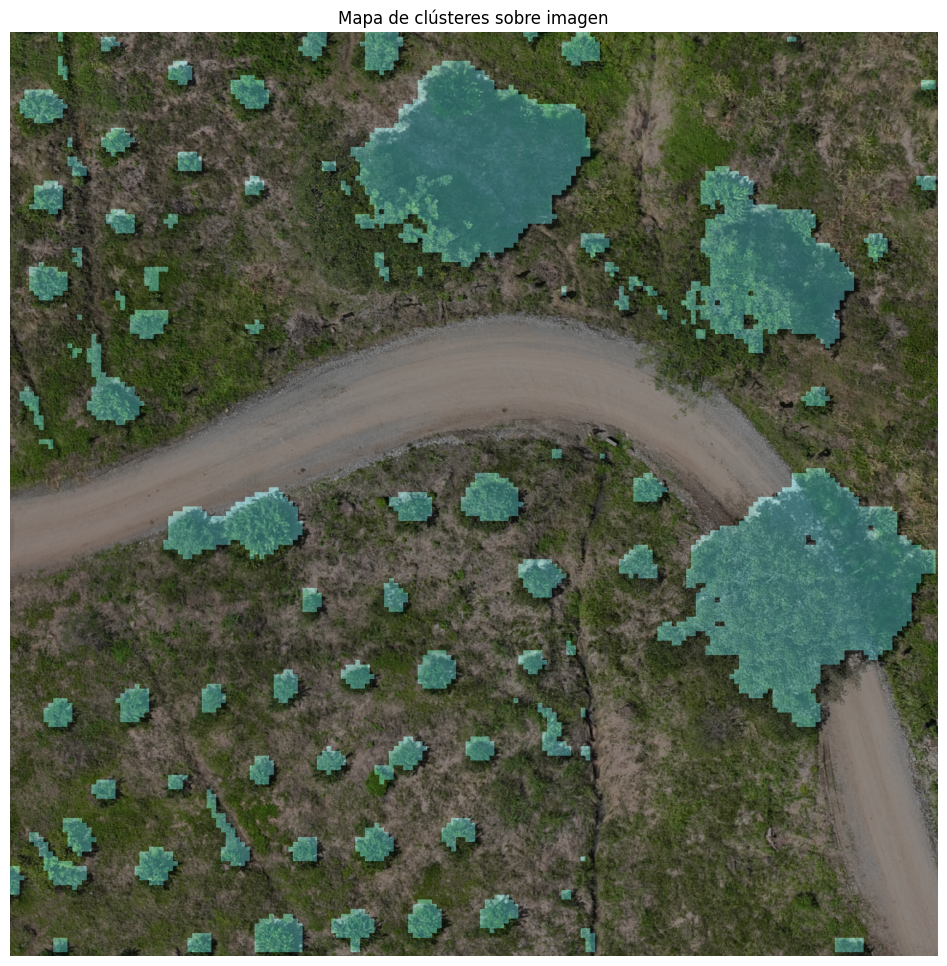

In [187]:
for imm in range(3):
    imagen_tiff = os.path.join("Samples", f"single_batch_{imm}.tif")
    with rasterio.open(imagen_tiff) as src:
        imagen = src.read()
        imagen = np.transpose(imagen, (1, 2, 0))  # Reordenar a (alto, ancho, bandas)
    visualizar_mapa_clusters_coloreado(imagen, modelo, tamano=30, stride=10,alpha=0.4,clustersP=[0])

c:\Users\EsSe009\Documents\Vision\EDA_Proyecto\.venv\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Se generaron 26180 parches de 9x9 con stride 3
Se construyó una matriz de características con forma: (26180, 384)
Se generaron 99528 parches de 9x9 con stride 3
Se construyó una matriz de características con forma: (99528, 384)
Se generaron 25122 parches de 9x9 con stride 3
Se construyó una matriz de características con forma: (25122, 384)
(150830, 384)
Aplicando K-Means con 7 clusters...
K-Means finalizado.


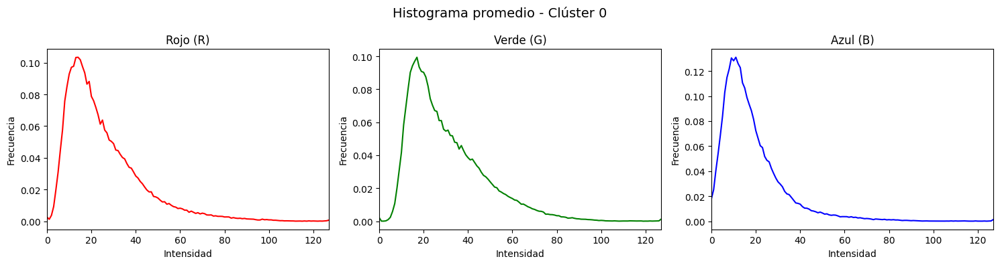

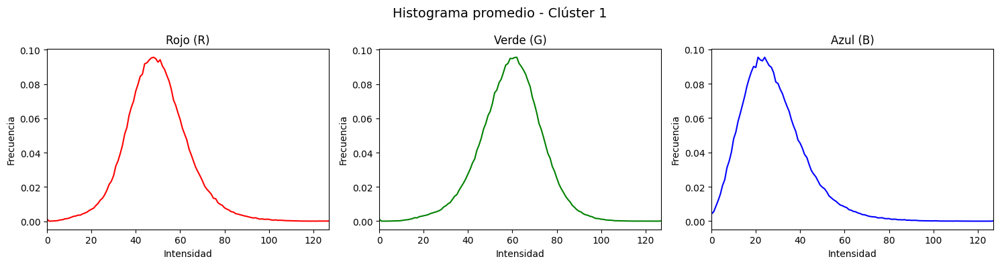

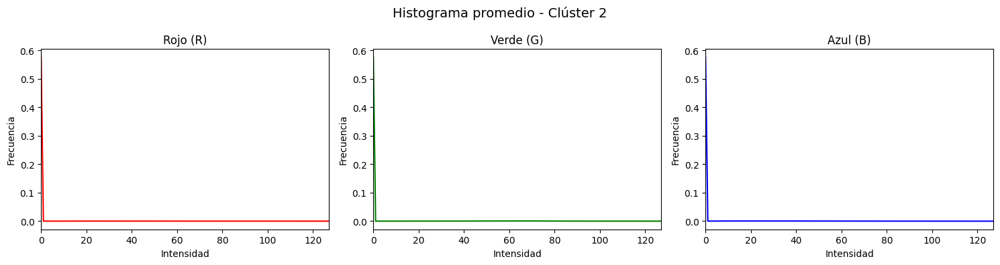

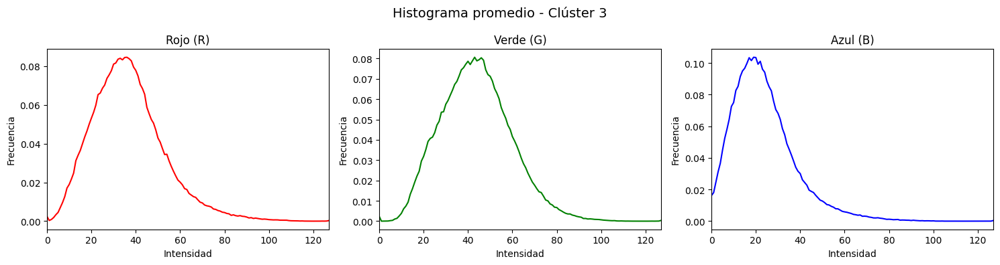

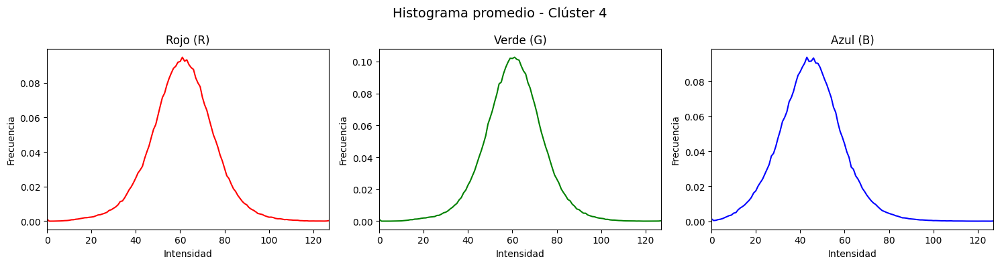

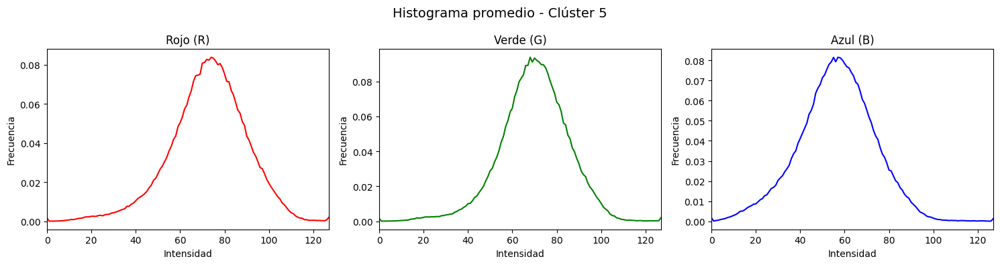

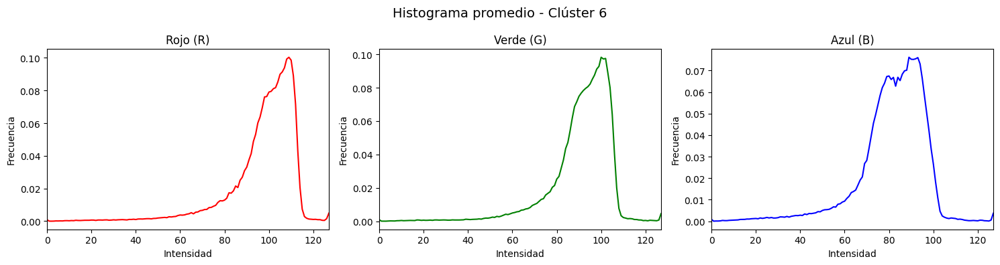

In [271]:
import cv2
Xs=[]
for imm in range(3):
    imagen_tiff = os.path.join("Samples", f"single_batch_{imm}.tif")
    with rasterio.open(imagen_tiff) as src:
        imagen = src.read()
        imagen = np.transpose(imagen, (1, 2, 0))  # Reordenar a (alto, ancho, bandas)
        imagen=cv2.resize(imagen, (imagen.shape[1]//4, imagen.shape[0]//4), interpolation=cv2.INTER_CUBIC)
    parches=generar_patches_solapados(imagen,9,3)
    Xs.append( construir_vectores_caracteristicas(parches,128))
X=np.concatenate(Xs)

print(X.shape)
X = normalize(X, norm='l2')  # L2 = coseno equivalente

labels, modelo = aplicar_kmeans(X, n_clusters=7)         
visualizar_histogramas_promedio(X,labels,128)

c:\Users\EsSe009\Documents\Vision\EDA_Proyecto\.venv\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


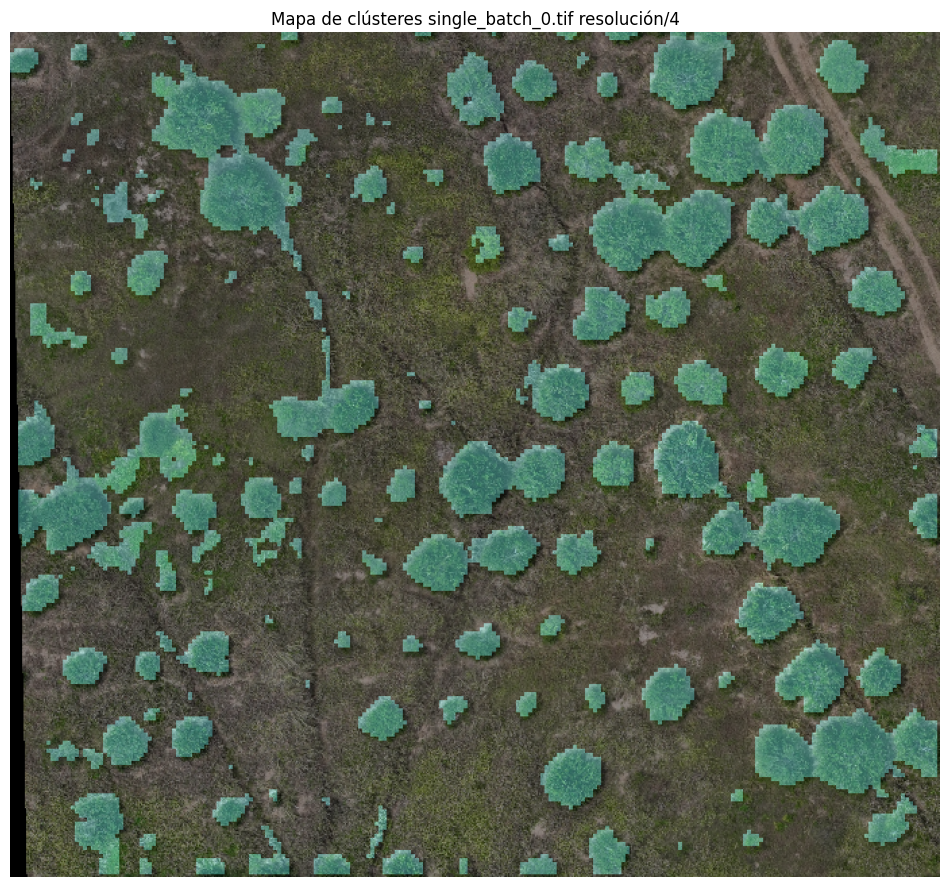

c:\Users\EsSe009\Documents\Vision\EDA_Proyecto\.venv\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


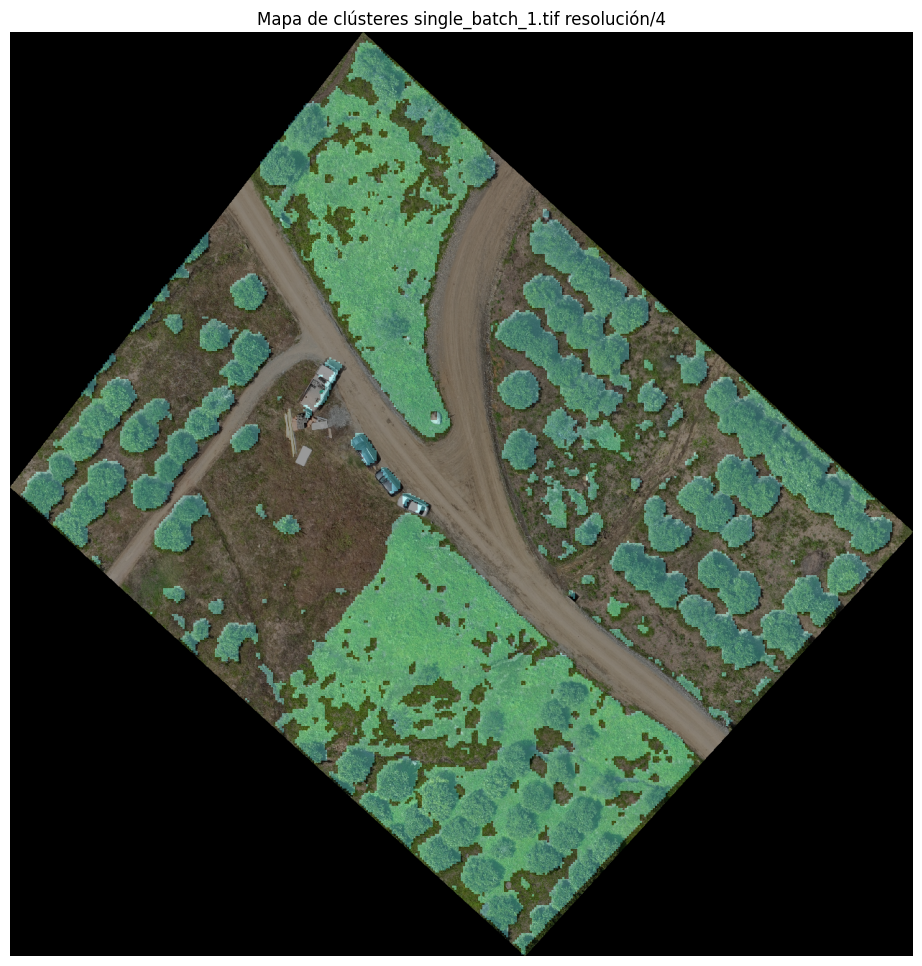

c:\Users\EsSe009\Documents\Vision\EDA_Proyecto\.venv\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


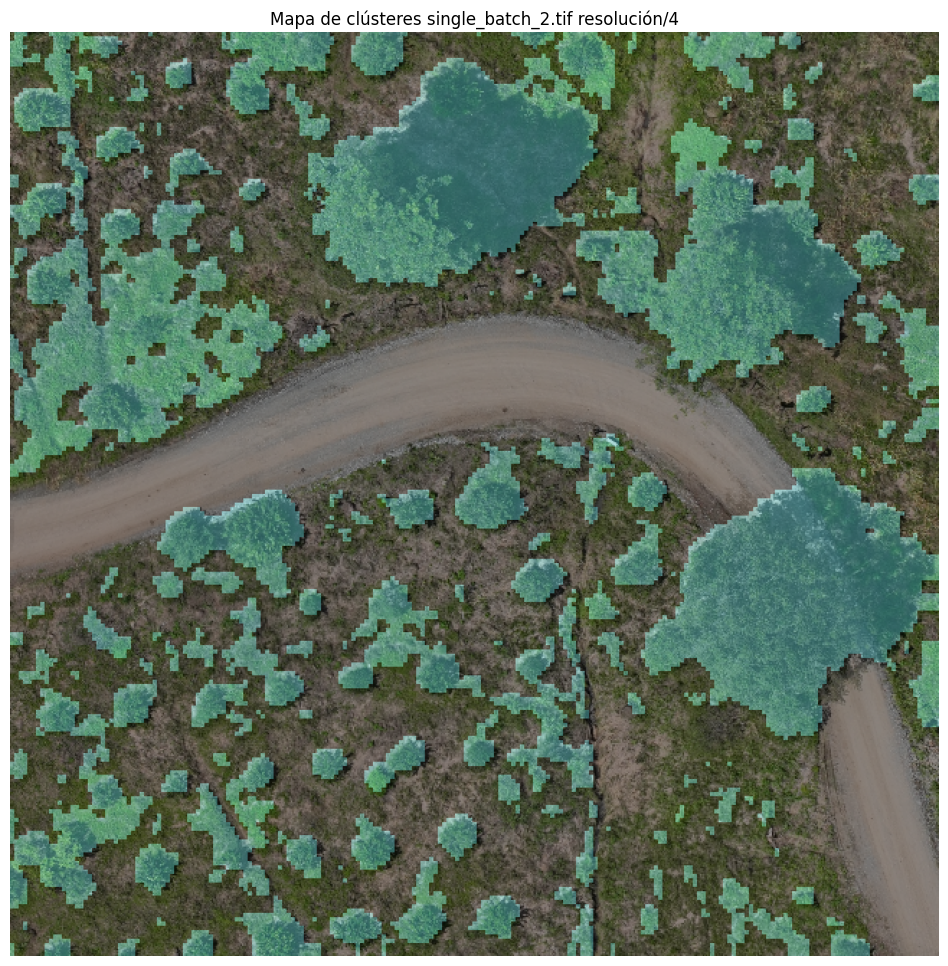

In [270]:
for imm in range(3):
    imagen_tiff = os.path.join("Samples", f"single_batch_{imm}.tif")
    with rasterio.open(imagen_tiff) as src:
        imagen = src.read()
        imagen = np.transpose(imagen, (1, 2, 0))  # Reordenar a (alto, ancho, bandas)
        imagen=cv2.resize(imagen, (imagen.shape[1]//3, imagen.shape[0]//3), interpolation=cv2.INTER_CUBIC)
    visualizar_mapa_clusters_coloreado(imagen, modelo, tamano=9, 
                                       stride=3,alpha=0.4,
                                       clustersP=[0],Title=f"Mapa de clústeres single_batch_{imm}.tif resolución/4",
                                       bins=128)

In [213]:
from sklearn.metrics import silhouette_score

def calcular_silueta(modelo, X):
    """
    Calcula el coeficiente de silueta de un modelo de clustering.

    Parámetros:
    - modelo: modelo ya entrenado (por ejemplo, KMeans)
    - X: matriz de características usada para entrenarlo

    Retorna:
    - silueta: valor promedio del coeficiente de silueta (entre -1 y 1)
    """
    labels = modelo.labels_
    score = silhouette_score(X, labels)
    print(f"Coeficiente de silueta: {score:.4f}")
    return score

calcular_silueta(modelo,X)

Coeficiente de silueta: 0.4002


np.float64(0.40024181163429823)

In [214]:
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.pyplot as plt
import numpy as np

def grafico_silueta_con_destacado(X, labels, cluster_destacado=None):
    """
    Dibuja el gráfico de silueta para todos los clústeres, destacando uno con color especial.

    Parámetros:
    - X: matriz de características
    - labels: etiquetas de clúster para cada muestra
    - cluster_destacado: número del clúster a resaltar (los demás se ven en gris)
    """
    n_clusters = len(np.unique(labels))
    siluetas = silhouette_samples(X, labels)
    promedio = silhouette_score(X, labels)

    fig, ax = plt.subplots(figsize=(10, 6))
    y_bajo = 10

    colores = plt.cm.tab10.colors
    for cl in np.unique(labels):
        # Siluetas del clúster actual
        valores_cl = siluetas[labels == cl]
        valores_cl.sort()

        y_alto = y_bajo + len(valores_cl)

        # Color resaltado o gris
        color = colores[cl % len(colores)] if cl == cluster_destacado else 'lightgray'
        ax.fill_betweenx(np.arange(y_bajo, y_alto), 0, valores_cl,
                         facecolor=color, edgecolor='k', alpha=0.7)

        ax.text(-0.05, y_bajo + len(valores_cl) / 2, f'Clúster {cl}')
        y_bajo = y_alto + 10

    ax.axvline(promedio, color='red', linestyle='--', label=f'Promedio global: {promedio:.2f}')
    ax.set_title("Gráfico de Silueta (resaltando clúster)")
    ax.set_xlabel("Coeficiente de silueta")
    ax.set_ylabel("Índice de muestra")
    ax.legend()
    plt.tight_layout()
    plt.show()


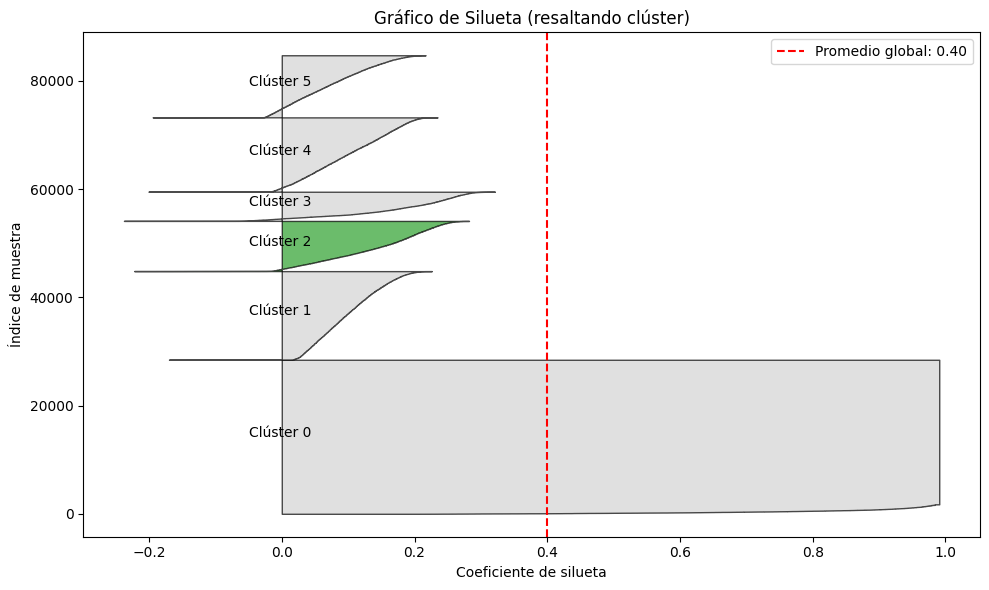

In [215]:
grafico_silueta_con_destacado(X, labels, cluster_destacado=2)


In [220]:
def eliminar_filas_con_ceros(X, umbral=0.95):
    """
    Elimina filas con un porcentaje de ceros mayor o igual al umbral dado.

    Parámetros:
    - X: matriz NumPy (2D)
    - umbral: porcentaje máximo permitido de ceros (default 0.95)

    Retorna:
    - X_filtrado: matriz sin las filas que superan el umbral
    """
    n_elementos = X.shape[1]
    porcentaje_ceros = (X == 0).sum(axis=1) / n_elementos
    mascara = porcentaje_ceros < umbral
    X_filtrado = X[mascara]
    print(f"Filas eliminadas: {(~mascara).sum()} / {X.shape[0]}")
    return X_filtrado

xFilt=eliminar_filas_con_ceros(X)
xFilt.shape

Filas eliminadas: 27006 / 84692


(57686, 384)

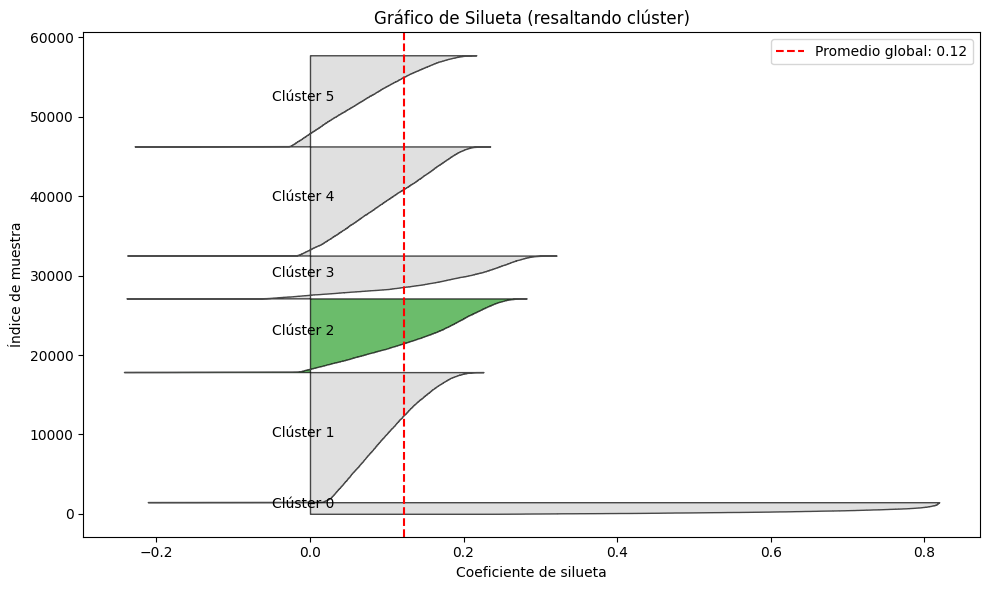

In [222]:
labels2=modelo.predict(xFilt)
grafico_silueta_con_destacado(xFilt, labels2, cluster_destacado=2)

HOG

In [228]:
from skimage.feature import hog
import numpy as np
import matplotlib.pyplot as plt

def extraer_vectores_hog(parches, orientaciones=9, pixeles_por_celda=(10, 10),
                         celdas_por_bloque=(2, 2), visualizar=False):
    """
    Extrae descriptores HOG desde parches (usando bandas G y B), descartando parches con vectores inconsistentes.

    Parámetros:
    - parches: lista de arrays (H, W, >=3)
    - orientaciones: número de bins de orientación
    - pixeles_por_celda: tamaño de celda
    - celdas_por_bloque: bloques para normalización
    - visualizar: mostrar un ejemplo HOG

    Retorna:
    - X: array 2D (n_patches_validos, n_features)
    """
    caracteristicas = []
    vector_referencia = None
    descartados = 0
    muestra_visual = None

    for i, parche in enumerate(parches):
        # Convertir a gris a partir de verde y azul
        verde = parche[:, :, 1]
        azul = parche[:, :, 2]
        imagen_gris = ((verde + azul) / 2).astype(np.uint8)

        try:
            vec_hog = hog(imagen_gris,
                          orientations=orientaciones,
                          pixels_per_cell=pixeles_por_celda,
                          cells_per_block=celdas_por_bloque,
                          block_norm='L2-Hys',
                          visualize=False,
                          feature_vector=True)

            # Validamos consistencia de longitud
            if vector_referencia is None:
                vector_referencia = len(vec_hog)
            if len(vec_hog) != vector_referencia:
                descartados += 1
                continue

            caracteristicas.append(vec_hog)

            # Solo una visualización si se pidió
            if visualizar and muestra_visual is None:
                _, imagen_hog = hog(imagen_gris,
                                    orientations=orientaciones,
                                    pixels_per_cell=pixeles_por_celda,
                                    cells_per_block=celdas_por_bloque,
                                    block_norm='L2-Hys',
                                    visualize=True,
                                    feature_vector=True)
                muestra_visual = (imagen_gris, imagen_hog)

        except Exception as e:
            descartados += 1
            continue

    X = np.array(caracteristicas)
    print(f"Vectores HOG extraídos: {X.shape}")
    print(f"Parches descartados por inconsistencia: {descartados}")

    if visualizar and muestra_visual:
        gris, hog_vis = muestra_visual
        plt.figure(figsize=(10, 4))
        plt.subplot(1, 2, 1)
        plt.imshow(gris, cmap='gray')
        plt.title("Imagen gris (G+B)")
        plt.axis('off')

        plt.subplot(1, 2, 2)
        plt.imshow(hog_vis, cmap='gray')
        plt.title("Visualización HOG")
        plt.axis('off')
        plt.tight_layout()
        plt.show()

    return X


c:\Users\EsSe009\Documents\Vision\EDA_Proyecto\.venv\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Se generaron 35532 parches de 50x50 con stride 10
Vectores HOG extraídos: (35532, 576)
Parches descartados por inconsistencia: 0


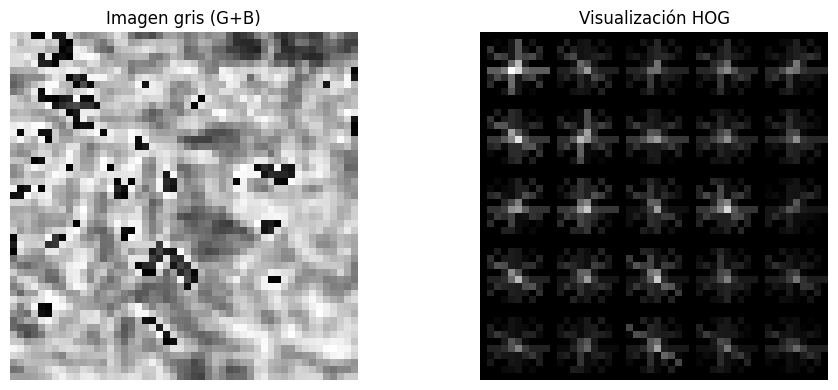

Se construyó una matriz de características con forma: (35532, 384)
(35532, 960)


In [256]:

imagen_tiff = os.path.join("Samples", f"single_batch_{2}.tif")
with rasterio.open(imagen_tiff) as src:
    imagen = src.read()
    imagen = np.transpose(imagen, (1, 2, 0))  # Reordenar a (alto, ancho, bandas)
parches=generar_patches_solapados(imagen,50,10)
Xs = extraer_vectores_hog(parches,
                          pixeles_por_celda=(10, 10),
                          celdas_por_bloque=(2, 2),
                          visualizar=True)
Xscolor=construir_vectores_caracteristicas(parches,128)

Xnew=np.concatenate([Xs,Xscolor],1)
print(Xnew.shape)


In [257]:
labesh,modeloh=aplicar_kmeans(Xs,5)

Aplicando K-Means con 5 clusters...
K-Means finalizado.


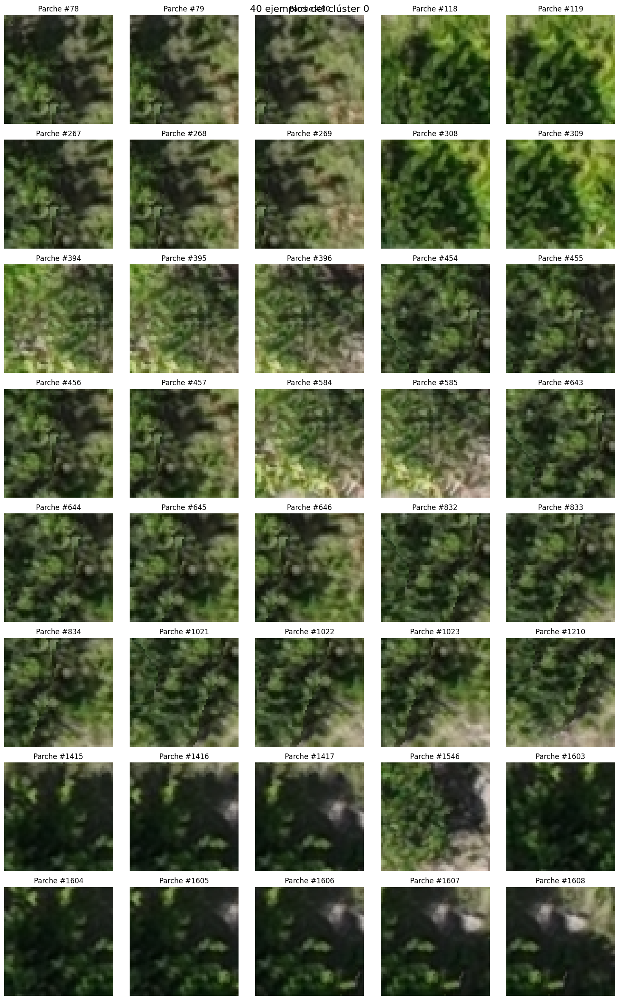

In [259]:
mostrar_ejemplos_cluster(parches,labesh,0,40)


In [260]:
NewMAp=reconstruir_mapa_clusters(imagen,labesh,50,10,10,1000)

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277


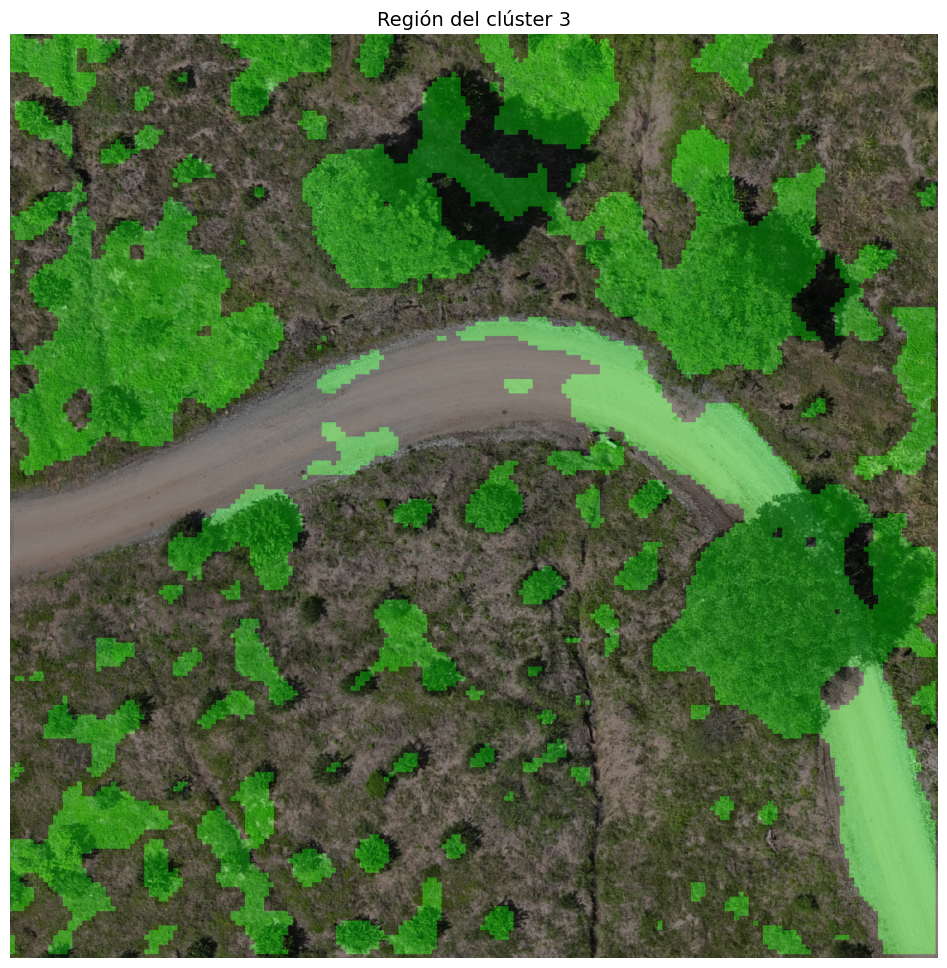

In [267]:
visualizar_mapa_reconstruido(imagen,NewMAp,alpha=0.4,cluster_destacado=3,color_destacado=(0,200,0))

In [249]:
Xs

array([[0.24463828, 0.11362959, 0.22877095, ..., 0.17885452, 0.12626175,
        0.08769251],
       [0.15421743, 0.05700347, 0.09645785, ..., 0.08985853, 0.0779269 ,
        0.27575841],
       [0.24100662, 0.1547656 , 0.13949199, ..., 0.25070811, 0.11312497,
        0.1328211 ],
       ...,
       [0.24322825, 0.07705615, 0.05121665, ..., 0.1284287 , 0.1263959 ,
        0.08821777],
       [0.24204072, 0.16521074, 0.03332725, ..., 0.23752746, 0.23752746,
        0.23752746],
       [0.23238793, 0.10927544, 0.10581281, ..., 0.19355271, 0.10407446,
        0.22339038]], shape=(35532, 576))